# Mask R-CNN demo

This notebook illustrates one possible way of using `maskrcnn_benchmark` for computing predictions on images from an arbitrary URL.

Let's start with a few standard imports

In [52]:
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab

import requests
from io import BytesIO
from PIL import Image
import numpy as np
import torch
from skimage.io import imread

In [53]:
# this makes our figures bigger
pylab.rcParams['figure.figsize'] = 20, 12

Those are the relevant imports for the detection model

In [54]:
from maskrcnn_benchmark.config import cfg

In [55]:
def load(url):
    """
    Given an url of an image, downloads the image and
    returns a PIL image
    """
    response = requests.get(url)
    pil_image = Image.open(BytesIO(response.content)).convert("RGB")
    # convert to BGR format
    image = np.array(pil_image)[:, :, [2, 1, 0]]
    return image

def imshow(img):
    plt.imshow(img[:, :, [2, 1, 0]])
    plt.axis("off")

We provide a helper class `COCODemo`, which loads a model from the config file, and performs pre-processing, model prediction and post-processing for us.

We can configure several model options by overriding the config options.
In here, we make the model run on the CPU

In [56]:
config_file = "../configs/caffe2/e2e_mask_rcnn_R_50_FPN_1x_caffe2.yaml"

#'../configs/e2e_mask_rcnn_fbnet.yaml'#"../configs/e2e_mask_rcnn_fbnet.yaml"#"../configs/caffe2/e2e_mask_rcnn_R_50_FPN_1x_caffe2.yaml"

# update the config options with the config file
cfg.merge_from_file(config_file)
# manual override some options
cfg.merge_from_list(["MODEL.DEVICE", "cpu"])

Now we create the `COCODemo` object. It contains a few extra options for conveniency, such as the confidence threshold for detections to be shown.

In [57]:
from predictor_nms import COCODemo

In [58]:
model_name = 'final'
weight_dir = '../model_{}.pth'.format(model_name)#'../datasets/tless/Trained_Model/2019_06_04/model_{}.pth'.format(model_name)#'../datasets/tless/Trained_Model/2019_06_04/model_{}.pth'.format(model_name)#'../model_{}.pth'.format(model_name)#'../datasets/tless/Trained_Model/2019_06_04/model_{}.pth'.format(model_name)
image_size = 540
coco_demo = COCODemo(
    cfg,
    min_image_size=image_size,
    confidence_threshold=0.0,
    load_weight = weight_dir
)

Loaded trained model weight.


In [49]:
import time

Processing Image Index : 1
Processing Image Index : 2
Processing Image Index : 3
Processing Image Index : 4
Processing Image Index : 5
Processing Image Index : 6
Processing Image Index : 7
Processing Image Index : 8
Processing Image Index : 9
Processing Image Index : 10
Processing Image Index : 11
Processing Image Index : 12
Processing Image Index : 13
Processing Image Index : 14
Processing Image Index : 15
Processing Image Index : 16
Processing Image Index : 17
Processing Image Index : 18
Processing Image Index : 19
Processing Image Index : 20
0.4484294931093852


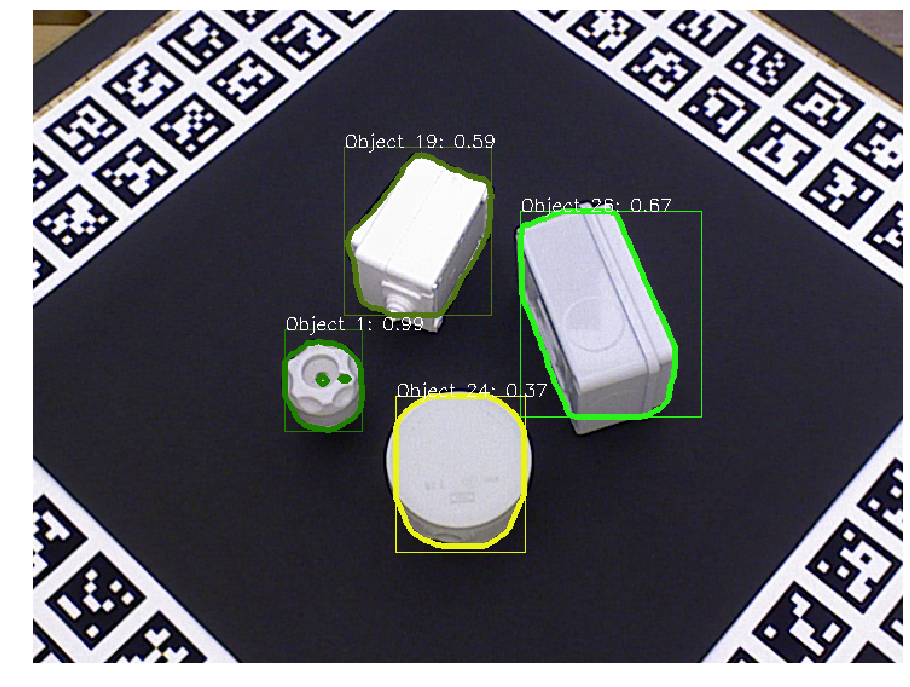

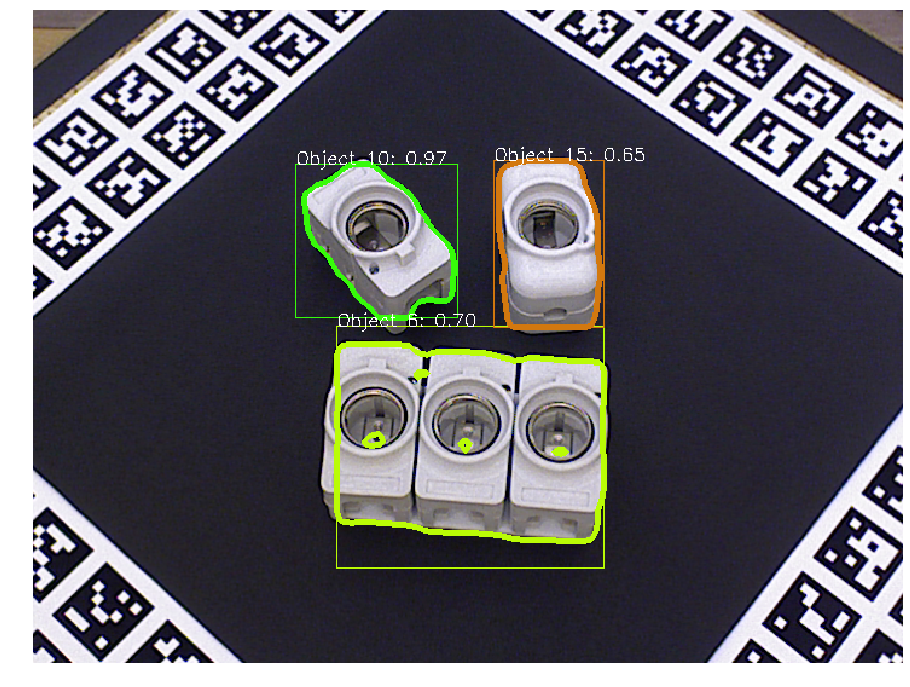

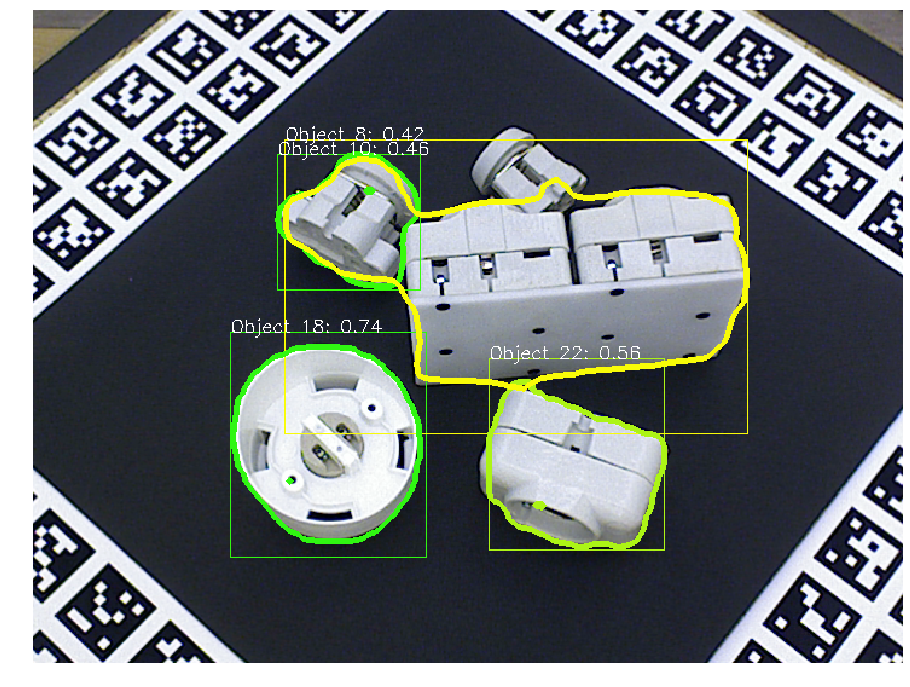

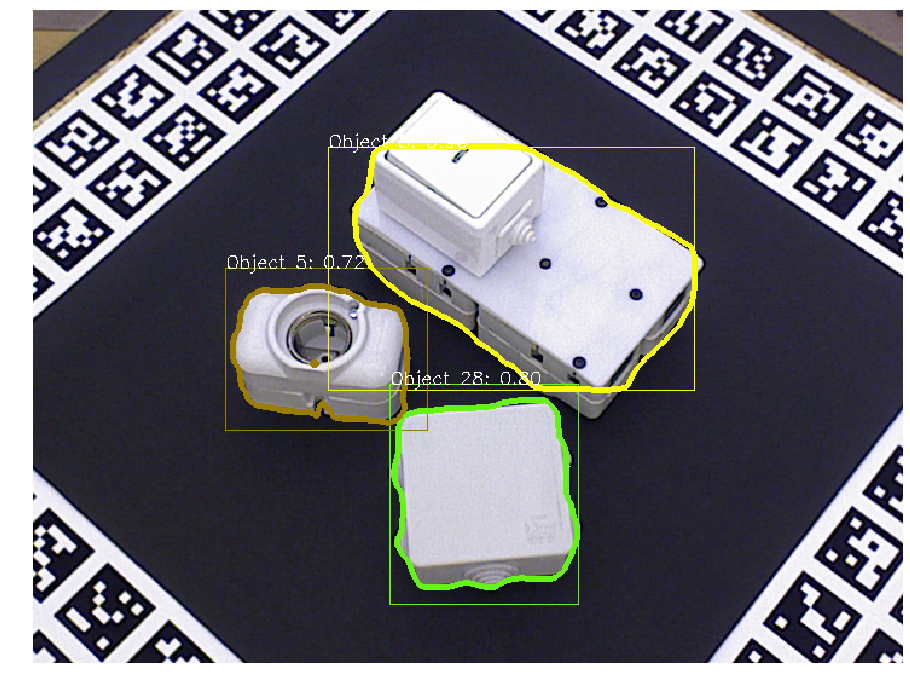

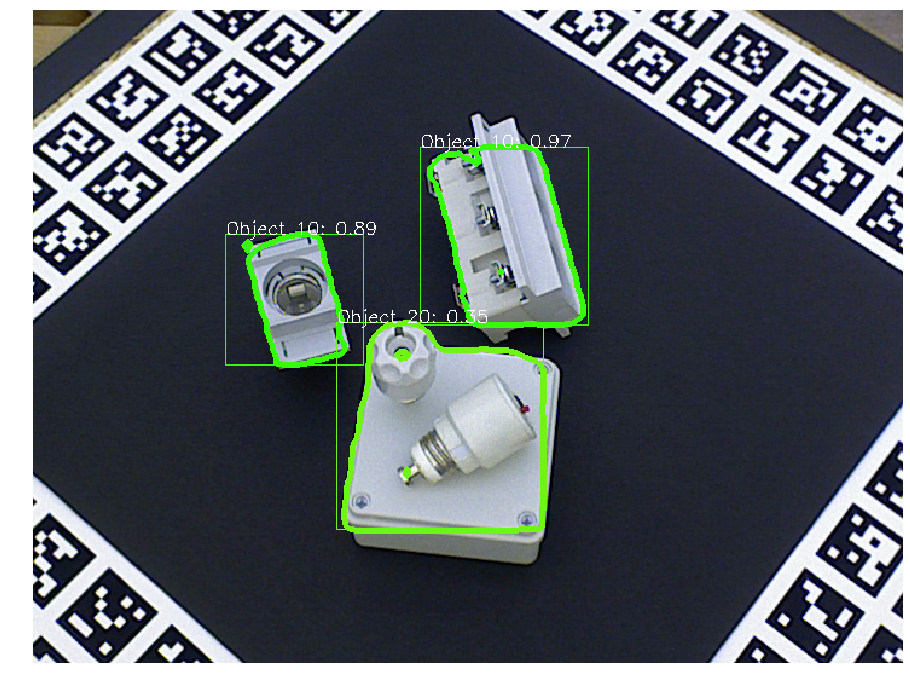

...

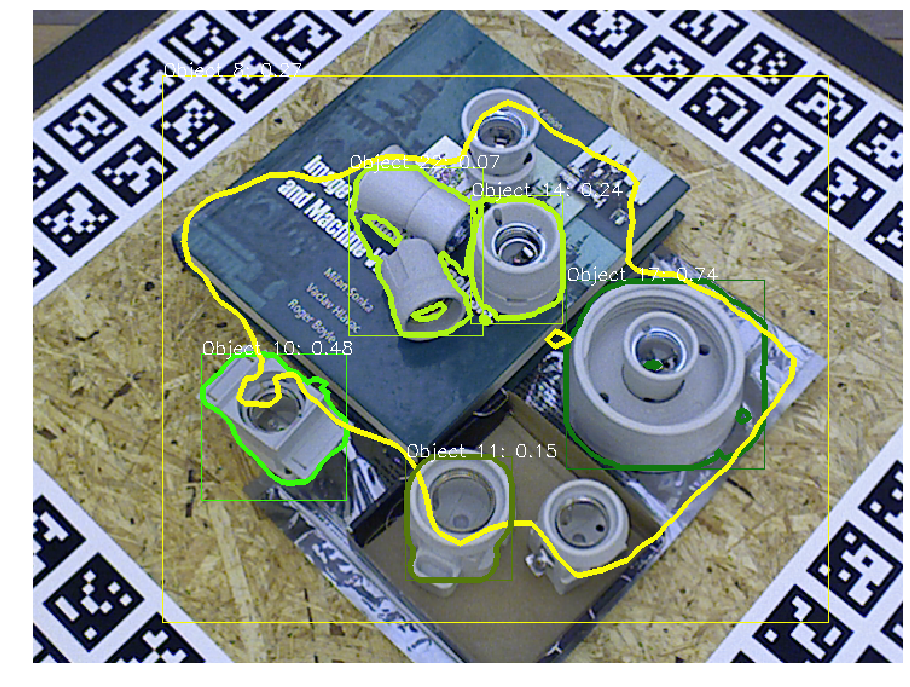

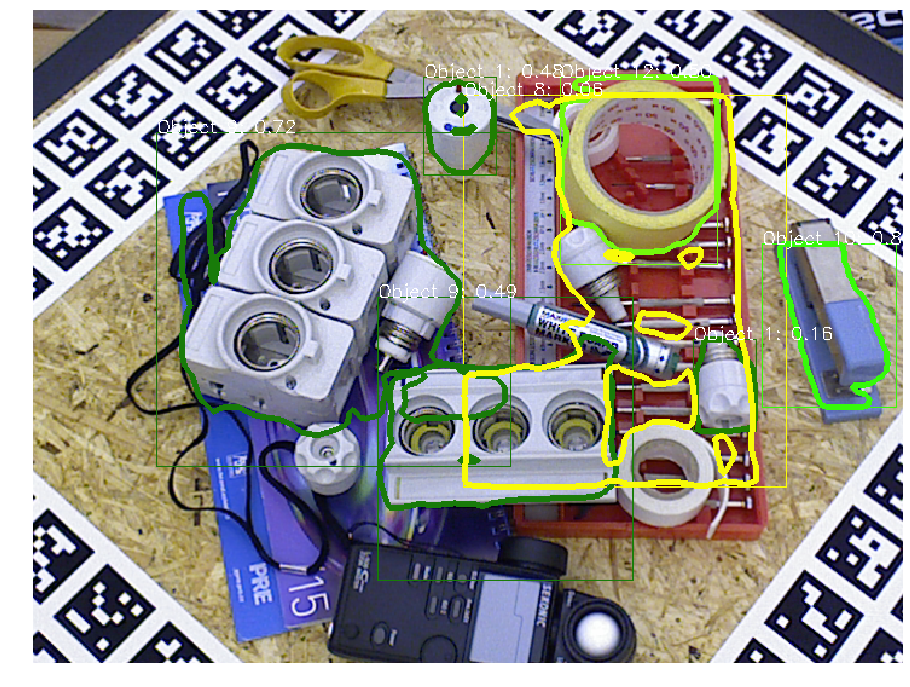

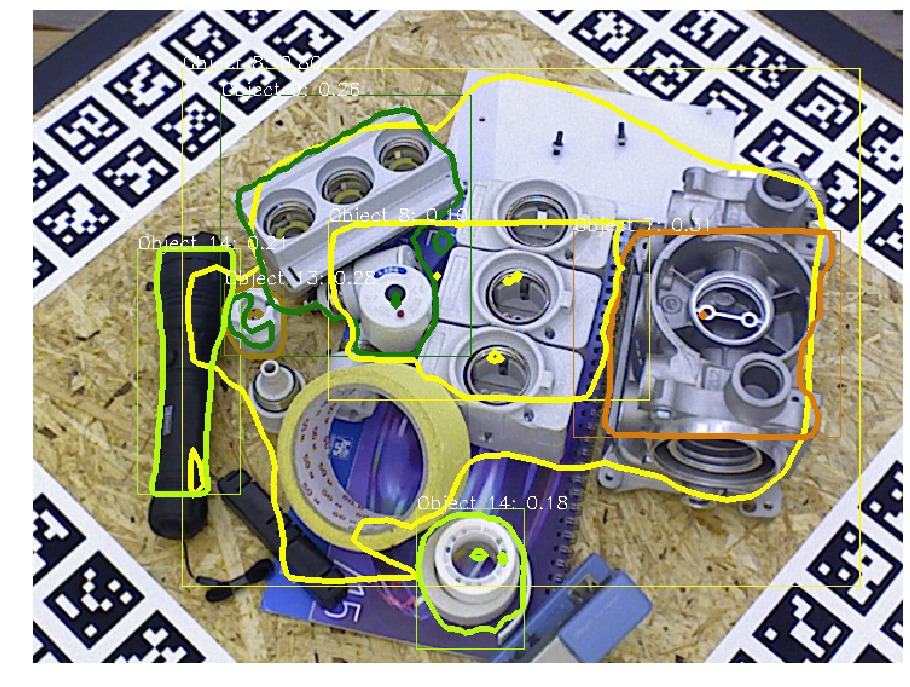

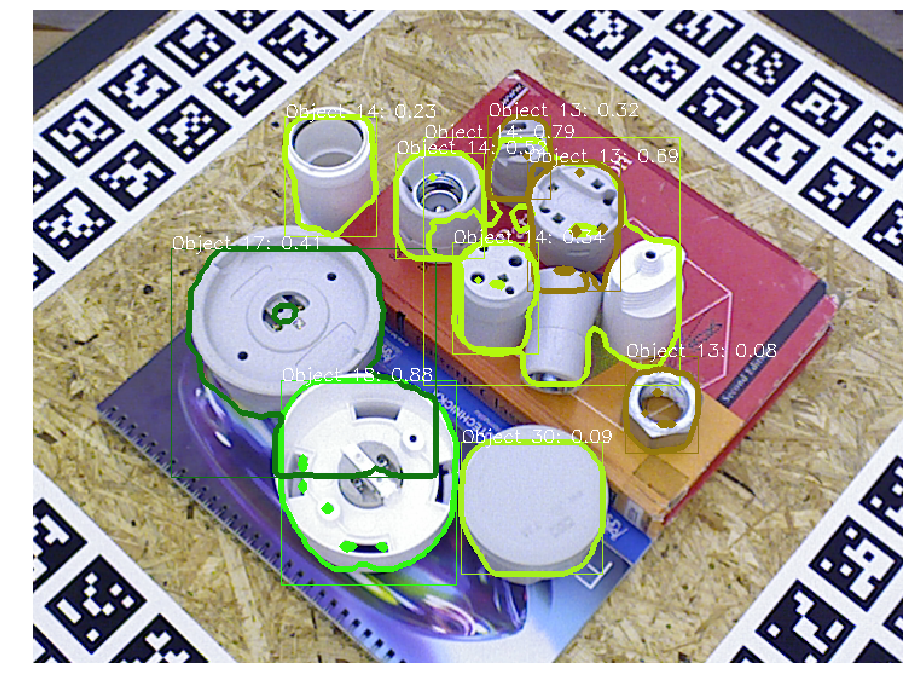

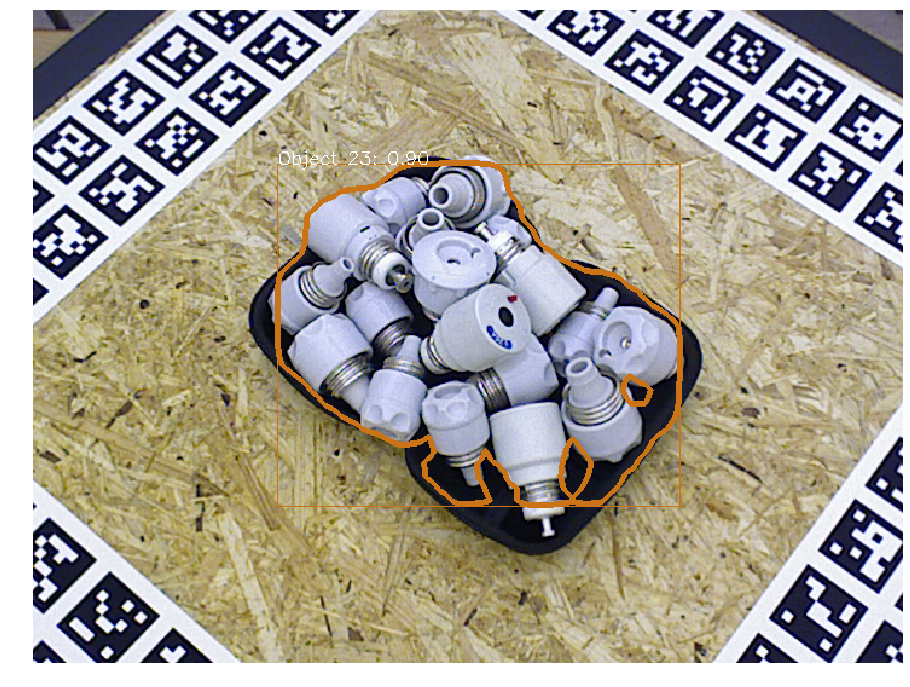

In [62]:
start = time.time()

for idx in range(0,20,1):
    #img_idx = '{:0>2d}'.format(idx+ 1)
    img_id = 80
    print('Processing Image Index : {}'.format(idx+1))
    image = imread('/mnt/DATA/Download/Dataset/t-less_v2/test_primesense/{:0>2d}/rgb/{:0>4d}.png'.format(idx+1, img_id))
    #imread('./Test.jpg')

    image = np.array(image)[:, :, [2, 1, 0]]
    #print(image.shape)
    predictions = coco_demo.run_on_opencv_image(image, nms_thresh=0.25)

    #print(type(predictions))
    #predictions.save("{}.jpg".format(idx+1), "JPEG", quality=80, optimize=True, progressive=True)
    plot = plt.figure()
    imshow(predictions)
    plt.savefig('/mnt/DATA/Download/Dataset/t-less_v2/Result/test_{:0>2d}_{:0>4d}_{}_{}.jpg'.format(idx+1, img_id, model_name,image_size), quality=60, optimize=True, progressive=True)


end = time.time()
print((end-start)/60)

In [16]:
from maskrcnn_benchmark.structures.boxlists_ops import boxlist_nms

ModuleNotFoundError: No module named 'maskrcnn_benchmark.structures.boxlists_ops'

In [ ]:
# compute predictions

#print(image)
#image = Image.open('./0008.png').convert('RGB')
#print(image.size)
image = imread('/mnt/DATA/Download/Dataset/t-less_v2/test_primesense/01/rgb/0002.png')
#imread('./Test.jpg')

image = np.array(image)[:, :, [2, 1, 0]]
predictions = coco_demo.run_on_opencv_image(image)

imshow(predictions)

Let's define a few helper functions for loading images from a URL

Let's now load an image from the COCO dataset. It's reference is in the comment

In [ ]:
# from http://cocodataset.org/#explore?id=345434
image = load("https://www.abc.net.au/news/image/9857250-3x2-940x627.jpg")
imshow(image)

image = np.array(image)[:, :, [2, 1, 0]]
predictions = coco_demo.run_on_opencv_image(image)

imshow(predictions)


### Computing the predictions

We provide a `run_on_opencv_image` function, which takes an image as it was loaded by OpenCV (in `BGR` format), and computes the predictions on them, returning an image with the predictions overlayed on the image.

## Keypoints Demo

In [ ]:
# set up demo for keypoints
config_file = "../configs/caffe2/e2e_keypoint_rcnn_R_50_FPN_1x_caffe2.yaml"
cfg.merge_from_file(config_file)
cfg.merge_from_list(["MODEL.DEVICE", "cpu"])
cfg.merge_from_list(["MODEL.MASK_ON", False])

coco_demo = COCODemo(
    cfg,
    min_image_size=800,
    confidence_threshold=0.7,
)

In [ ]:
# run demo
#image = load("http://farm9.staticflickr.com/8419/8710147224_ff637cc4fc_z.jpg")
predictions = coco_demo.run_on_opencv_image(image)
imshow(predictions)

In [ ]:
x = torch.load('model_0035000.pth')['model']
print(x)